In [0]:
import keras
from keras.datasets import cifar10
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D,BatchNormalization,AveragePooling2D
from keras import regularizers
import numpy as np
import pandas as pd
from keras.models import model_from_json

In [2]:
from google.colab import files
files.upload()

Saving fer2013.csv to fer2013.csv


 fer2013.csv	  'piyush (1).jpeg'
'model (1).h5'	  'piyush (2).jpeg'
'model (1).json'  'piyush (3).jpeg'
'model (2).h5'	   piyush.jpeg
'model (2).json'   sample_data
 model.h5	  'WhatsApp Image 2019-01-12 at 6.59.06 PM.jpeg'
 model.json


In [134]:
with open("fer2013.csv") as f:
  content = f.readlines()
 
  lines = np.array(content)
 
  num_of_instances = lines.size
  print("number of instances: ",num_of_instances)


number of instances:  35888


In [0]:
df=pd.read_csv("fer2013.csv")

In [136]:
df.head()

,emotion,pixels,Usage
0,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...,Training
1,0,151 150 147 155 148 133 111 140 170 174 182 15...,Training
2,2,231 212 156 164 174 138 161 173 182 200 106 38...,Training
3,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...,Training
4,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...,Training


In [0]:
num_classes=7

In [0]:
x_train, y_train, x_test, y_test = [], [], [], []
 
for i in range(1,num_of_instances):
    emotion, img, usage = lines[i].split(",")
 
    val = img.split(" ")
    pixels = np.array(val, 'float32')
 
    emotion = keras.utils.to_categorical(emotion, num_classes)
 
    if 'Training' in usage:
      y_train.append(emotion)
      x_train.append(pixels)
    elif 'PublicTest' in usage:
      y_test.append(emotion)
      x_test.append(pixels)

In [0]:
x_train=np.array(x_train)
x_test=np.array(x_test)
y_train=np.array(y_train)
y_test=np.array(y_test)

In [140]:
x_train.shape,x_test.shape,y_train.shape,y_test.shape

((28709, 2304), (3589, 2304), (28709, 7), (3589, 7))

In [141]:
len(x_train),len(x_test),len(y_train),len(y_test)

(28709, 3589, 28709, 3589)

In [142]:
x_train.shape[1:]

(2304,)

In [0]:
model = Sequential()
 
#1st convolution layer
model.add(Conv2D(64, (5, 5), activation='relu', input_shape=(48,48,1)))
model.add(MaxPooling2D(pool_size=(5,5), strides=(2, 2)))
 
#2nd convolution layer
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(AveragePooling2D(pool_size=(3,3), strides=(2, 2)))
 
#3rd convolution layer
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(AveragePooling2D(pool_size=(3,3), strides=(2, 2)))
 
model.add(Flatten())
 
#fully connected neural networks
model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.2))
 
model.add(Dense(num_classes, activation='softmax'))


In [144]:
len(y_train),len(x_train)

(28709, 28709)

In [0]:
batch_size=32
epochs=25

In [0]:
x_train=np.array(x_train)
y_train=np.array(y_train)

In [0]:
x_train=x_train.reshape(-1,48,48,1)
x_test=x_test.reshape(-1,48,48,1)

In [0]:
#gen = ImageDataGenerator()
model.compile(loss='categorical_crossentropy',
              optimizer='Adam',
              metrics=['accuracy'])

In [149]:
batch_size=32
epochs=30
model.fit(x_train, y_train,
              batch_size=batch_size,
              epochs=epochs,
              validation_data=(x_test, y_test),
              shuffle=True)

Train on 28709 samples, validate on 3589 samples
Epoch 1/30
28709/28709 [==============================] - 23s 811us/step - loss: 1.7778 - acc: 0.2725 - val_loss: 1.6363 - val_acc: 0.3475
Epoch 2/30
28709/28709 [==============================] - 19s 673us/step - loss: 1.6060 - acc: 0.3636 - val_loss: 1.5400 - val_acc: 0.3890
Epoch 3/30
28709/28709 [==============================] - 19s 647us/step - loss: 1.5081 - acc: 0.4150 - val_loss: 1.4685 - val_acc: 0.4188
Epoch 4/30
28709/28709 [==============================] - 18s 644us/step - loss: 1.4321 - acc: 0.4453 - val_loss: 1.4278 - val_acc: 0.4503
Epoch 5/30
28709/28709 [==============================] - 19s 651us/step - loss: 1.3828 - acc: 0.4678 - val_loss: 1.3872 - val_acc: 0.4572
Epoch 6/30
28709/28709 [==============================] - 18s 642us/step - loss: 1.3279 - acc: 0.4921 - val_loss: 1.3434 - val_acc: 0.4787
Epoch 7/30
28709/28709 [==============================] - 18s 641us/step - loss: 1.2786 - acc: 0.5085 - val_loss: 1.3

In [150]:
scores = model.evaluate(x_test, y_test, verbose=1)
scores

3589/3589 [==============================] - 1s 202us/step


[2.199548572443029, 0.5271663416076351]

In [0]:
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)


In [152]:
model.save_weights("model.h5")
print("Saved model to disk")


Saved model to disk


In [0]:
files.download("model.h5")


In [0]:
files.download("model.json")

In [6]:
from google.colab import files
files.upload()

Saving model.h5 to model (2).h5
Saving model.json to model (2).json
Saving piyush.jpeg to piyush (3).jpeg


{'model.h5': b'\x89HDF\r\n\x1a\n\x00\x00\x00\x00\x00\x08\x08\x00\x04\x00\x10\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff@5[\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00`\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x88\x00\x00\x00\x00\x00\x00\x00\xa8\x02\x00\x00\x00\x00\x00\x00\x01\x00\x06\x00\x01\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x10\x00\x10\x00\x00\x00\x00\x00 \x03\x00\x00\x00\x00\x00\x00 \x02\x00\x00\x00\x00\x00\x00TREE\x00\x00\x03\x00\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x000\x00\x00\x00\x00\x00\x00\x00pz\x12\x00\x00\x00\x00\x00\xb0\x00\x00\x00\x00\x00\x00\x00\xd8\xb8Z\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x

In [159]:
!ls


 fer2013.csv	'model (1).json'   model.json
'model (1).h5'	 model.h5	   sample_data


In [4]:
json_file = open('model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

NameError: ignored

In [5]:
loaded_model.load_weights("model.h5")
print("Loaded model from disk")


NameError: ignored

In [189]:
from google.colab import files
files.upload()

Saving piyush.jpeg to piyush (2).jpeg


{'piyush.jpeg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00\x84\x00\x06\x06\x06\x06\x07\x06\x07\x08\x08\x07\n\x0b\n\x0b\n\x0f\x0e\x0c\x0c\x0e\x0f\x16\x10\x11\x10\x11\x10\x16"\x15\x19\x15\x15\x19\x15"\x1e$\x1e\x1c\x1e$\x1e6*&&*6>424>LDDL_Z_||\xa7\x01\x06\x06\x06\x06\x07\x06\x07\x08\x08\x07\n\x0b\n\x0b\n\x0f\x0e\x0c\x0c\x0e\x0f\x16\x10\x11\x10\x11\x10\x16"\x15\x19\x15\x15\x19\x15"\x1e$\x1e\x1c\x1e$\x1e6*&&*6>424>LDDL_Z_||\xa7\xff\xc2\x00\x11\x08\x04\x10\x02H\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x001\x00\x00\x03\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\xff\xda\x00\x0c\x03\x01\x00\x02\x10\x03\x10\x00\x00\x02\xe9~s\xd6;\xce\x16v\x9cmzW8\x9d\x0f\x9bC\xea\x13Y\xd0\x00\x0010\x00^\x7f\xa3\xe6\x18\xe2\xe4\x8c\xf5\x95\xc5jF\x0fB\xa7X\xda\xcc\xf3\xd7\x08\xb7\x98hf\xcd\x0c\xc2\xfa9\xb79\x8d\x19\x94\xec\x8c\x96\xa8\xcd\x

NameError: ignored

In [0]:
from scipy.misc import imread
from scipy.misc import imresize
import numpy as np

In [0]:
filename="piyush.jpeg"

In [14]:
filename

'piyush.jpeg'

In [15]:
im = imread("piyush.jpeg")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """Entry point for launching an IPython kernel.


In [17]:
im.shape

(1040, 584, 3)

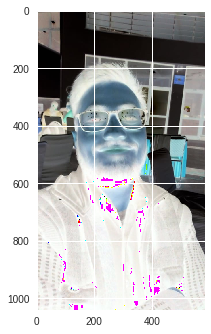

In [19]:
first_image=im
first_image=np.array(first_image,'float')
plt.imshow(first_image)
plt.show()

In [8]:
im = imread("piyush.jpeg")
im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
im=im/255.
im=im.reshape(im.shape+(1,))
print(im.shape)


(1040, 584, 1)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """Entry point for launching an IPython kernel.


TypeError: ignored

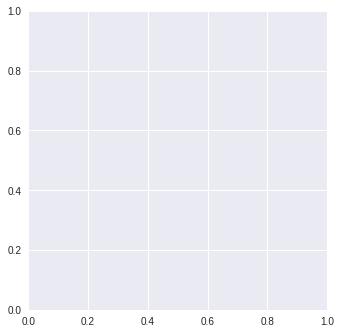

In [0]:
import cv2
import matplotlib.pyplot as plt

In [0]:
image = cv2.imshow("f",im)
plt.plot(im)
plt.show()


In [186]:
im.shape

(1040, 584)

In [0]:
im=

In [0]:
im=im.reshape((1,)+im.shape)

In [0]:
img = cv2.resize(im,(48,48))

In [177]:
im.shape

(1, 1040, 584)

In [170]:
im=im.reshape(48,48,1)

ValueError: ignored

In [210]:
loaded_model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])
score = loaded_model.predict_classes(im, verbose=1)

1/1 [==============================] - 1s 553ms/step


In [211]:
print(score)

[0]


In [0]:
train_score = model.evaluate(x_train, y_train, verbose=0)
print('Train loss:', train_score[0])
print('Train accuracy:', 100*train_score[1])
 
test_score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss:', test_score[0])
print('Test accuracy:', 100*test_score[1])
